<a href="https://colab.research.google.com/github/mattshu0410/Peripheral-Blood-Deep-Learning/blob/main/Blood_Cell_YOLOv5_Implementation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# BCCD Detection w/ YOLOv5 

Adapted from: https://github.com/bala-codes/Yolo-v5_Object_Detection_Blood_Cell_Count_and_Detection

# Ingesting Data

The data is acquired from RoboFlow, with supposedly improved labelling. It comes separated into test, train and validation and already has a series of augmentation applied including:



*   Flip
    *   Horizontal, Vertical
*   90° Rotate
    *   Clockwise, Counter-Clockwise, Upside Down
*   Crop
    *   0% Minimum Zoom, 15% Maximum Zoom
*   Hue
    *   Between -25° and +25°
*   Saturation
    *   Between -25% and +25%
*   Brightness
    *   Between -15% and +15%
*   Exposure
    *   Between -20% and +20%




https://public.roboflow.com/object-detection/bccd/4

In [ ]:
#Mount drive first
#Unzip dataset located in Colab Notebooks folder in my drive
!unzip drive/MyDrive/Colab\ Notebooks/BCCD.v4-416x416_aug.yolov5pytorch.zip

# Prepare YOLOV5s Model

Models are loaded from GitHub. There are two YAML files; one is the data YAML file and the other is the model YAML file. YOLOV5s is a model that is pretrained on the COCO dataset so the number of classes is 80 originally. We specify 3 categories to match our use case so it is not overidden during training. We are making use of transfer learning here.

*   train: /content/train/images
*   valid: /content/valid/images
*   nc: 3 
*   names: ['RBC', 'WBC', 'platelets']

YOLOV5s model expects data in the following format:

<img src="https://miro.medium.com/max/268/1*p2uV0eRlqGorcjuKA6TMeA.png">

Within these folders, each image (.png) has a unique identifier which corresponds to a text file (.txt) containing annotations. These annotations indicate describe bounding boxes of various objects inside the image. These annotations following the following format. All measurements are normalised i.e. divided by either width or height depending on the appropriate axis.

*   class_id (enumerated from 0) - What is the object?
*   center_x - What is the normalised x-coordinate of the centre of the bbox
*   center_y - What is the normalised y-coordinate of the centre of the bbox
*   width - What is the normalised width of bbox?
*   height - What is the normalised height of the bbox?

In [ ]:
#Install dependencies for YOLOv5
!pip install -r https://raw.githubusercontent.com/ultralytics/yolov5/master/requirements.txt

     |████████████████████████████████| 596 kB 5.3 MB/s 
  Attempting uninstall: PyYAML
    Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13


In [ ]:
#Clones repository containing models from Git Repo: https://github.com/ultralytics/yolov5
!git clone  'https://github.com/ultralytics/yolov5.git'

Cloning into 'yolov5'...
remote: Enumerating objects: 10429, done.
remote: Counting objects: 100% (10/10), done.
remote: Compressing objects: 100% (9/9), done.
remote: Total 10429 (delta 2), reused 8 (delta 1), pack-reused 10419
Receiving objects: 100% (10429/10429), 10.60 MiB | 22.42 MiB/s, done.
Resolving deltas: 100% (7206/7206), done.


In [ ]:
import shutil #shell utilities
import PIL
from glob import glob
import numpy as np
import matplotlib.pyplot as plt

In [ ]:
# In-place stream editing of the YOLOV5s YAML where 's/old/new/g' s initiates regexp and g means global
!sed -i 's/nc: 80/nc: 3/g' ./yolov5/models/yolov5s.yaml # replace nc:80 wtih nc:3
!sed -i 's/\.\./\/content/g' data.yaml #replace .. with /content

In [ ]:
shutil.copyfile('/content/data.yaml', '/content/yolov5/data.yaml')

'/content/yolov5/data.yaml'

# Training Model

The following is a IPython feature shell command to initiate training

!python 
- <'location of train.py file'> 
- --img <'width of image'>
- --batch <'batch size'>
- --epochs <'no of epochs'>
- --data <'location of the .yaml file'>
- --cfg <'Which yolo configuration you want'>(yolov5s/yolov5m/yolov5l/yolov5x).yaml | (small, medium, large, xlarge)
- --name <'Name of the best model after training'>

All `%` prefixed are IPython notebook magic functions.

Batch size is the number of training samples used in a single iteration. A smaller batch size means a greater influence from noise because only one data point is used. However, this usually also means that they can potentially converge faster (although this is dependent on the problem and data). Most of the time the batch size is limited by memory available.

For further reading see: https://stackoverflow.com/questions/44483233/is-using-batch-size-as-powers-of-2-faster-on-tensorflow

Epoch refers to the number of passes of over the full training dataset that the model has trained on.

In [ ]:
example_img = PIL.Image.open("/content/train/images/BloodImage_00001_jpg.rf.1a3206b15602db1d97193162a50bd001.jpg")
print(example_img.size) #Evidently our image size is 416

(416, 416)


In [ ]:
#how long cell takes to execute
%%time

!python ./yolov5/train.py --img 416 --batch 8 --epochs 100 --data ./yolov5/data.yaml --cfg ./yolov5/models/yolov5s.yaml --name BCCM


train: weights=yolov5/yolov5s.pt, cfg=./yolov5/models/yolov5s.yaml, data=./yolov5/data.yaml, hyp=yolov5/data/hyps/hyp.scratch.yaml, epochs=100, batch_size=8, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, adam=False, sync_bn=False, workers=8, project=yolov5/runs/train, name=BCCM, exist_ok=False, quad=False, linear_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.0-155-gdc54ed5 torch 1.10.0+cu111 CUDA:0 (Tesla K80, 11441MiB)

hyperparameters: lr0=0.01, lrf=0.1, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.015, hsv_s=

<IPython.core.display.Javascript object>

CPU times: user 44.1 s, sys: 6.23 s, total: 50.3 s
Wall time: 1h 5min 31s


# Training Metrics

You can use both TensorBoard to track metrics or graph them manually.

In [ ]:
#Visualisation tools from TensorFlow library to track metrics, model weights & biases over time
%reload_ext tensorboard
%tensorboard --logdir /content/yolov5/runs/

<IPython.core.display.Javascript object>

#Prediction

It is importamt to distinguish between training, validation and testing. Validation data is used during training to estimate how well the model has been trained. However when you actually want to see how the model might perform in the real world, this is when you use the test data.

`detect.py` automatically stores all predictions into a file path `yolov5/runs/detect/exp`. Depending on how many times this has been run it may be exp2 or exp3 and so on.

Below shows running a batch prediction as well as single predictions.



In [ ]:
!python /content/yolov5/detect.py --source /content/test/images/ --weights "/content/best.pt"

detect: weights=['/content/yolov5/runs/train/BCCM/weights/best.pt'], source=/content/test/images/, data=yolov5/data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=yolov5/runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.0-172-gfb83929 torch 1.10.0+cu111 CPU

Traceback (most recent call last):
  File "/content/yolov5/detect.py", line 257, in <module>
    main(opt)
  File "/content/yolov5/detect.py", line 252, in main
    run(**vars(opt))
  File "/usr/local/lib/python3.7/dist-packages/torch/autograd/grad_mode.py", line 28, in decorate_context
    return func(*args, **kwargs)
  File "/content/yolov5/detect.py", line 92, in run
    model = DetectMultiBackend(weights, device=device, dnn=dnn, data=data)
  File 

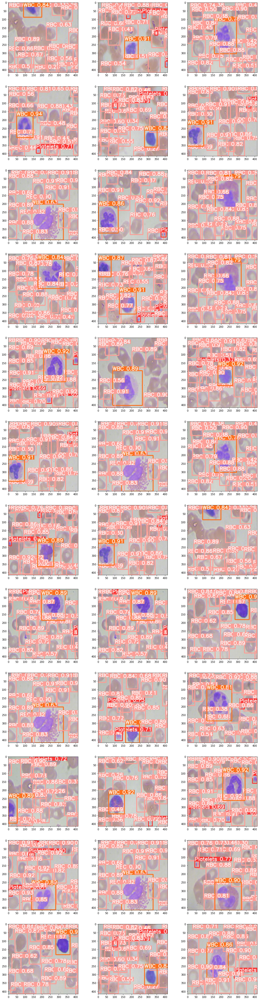

In [ ]:
images = glob("/content/yolov5/runs/detect/exp/*")
len(images)
fig = plt.figure(figsize = (18, 72))
columns = 3
rows = 12
for i in range(1, columns*rows+1):
  img = np.random.choice(images)
  img = plt.imread(img)
  fig.add_subplot(rows, columns, i)
  plt.imshow(img)
plt.show()

In [ ]:
!python /content/yolov5/detect.py --source /content/20x.jpeg --weights "/content/best.pt"

detect: weights=['/content/best.pt'], source=/content/PB_MGG_20211223_105525.jpeg, data=yolov5/data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=yolov5/runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.0-172-gfb83929 torch 1.10.0+cu111 CPU

Fusing layers... 
Model Summary: 213 layers, 7018216 parameters, 0 gradients, 15.8 GFLOPs
image 1/1 /content/PB_MGG_20211223_105525.jpeg: 288x640 Done. (0.189s)
Speed: 1.1ms pre-process, 189.1ms inference, 4.8ms NMS per image at shape (1, 3, 640, 640)
Results saved to yolov5/runs/detect/exp2


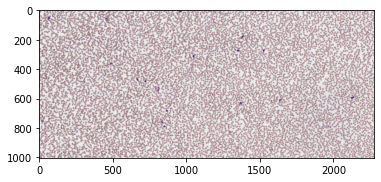

In [ ]:
img = plt.imread("/content/yolov5/runs/detect/exp2/20x.jpeg")
plt.imshow(img)

In [ ]:
!python /content/yolov5/detect.py --source /content/40x.jpeg --weights "/content/best.pt"

detect: weights=['/content/best.pt'], source=/content/40x.jpeg, data=yolov5/data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=yolov5/runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.0-172-gfb83929 torch 1.10.0+cu111 CPU

Fusing layers... 
Model Summary: 213 layers, 7018216 parameters, 0 gradients, 15.8 GFLOPs
image 1/1 /content/40x.jpeg: 288x640 3 RBCs, Done. (0.186s)
Speed: 1.1ms pre-process, 185.8ms inference, 10.9ms NMS per image at shape (1, 3, 640, 640)
Results saved to yolov5/runs/detect/exp4


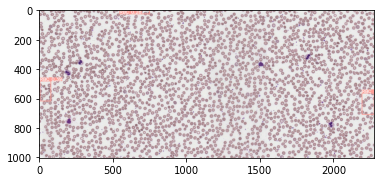

In [ ]:
img = plt.imread("/content/yolov5/runs/detect/exp4/40x.jpeg")
plt.imshow(img)

In [ ]:
!python /content/yolov5/detect.py --source /content/BloodImage_00266_jpg.rf.2521623f1047a9502b2705a626ad6655.jpg --weights "/content/best.pt"

detect: weights=['/content/best.pt'], source=/content/BloodImage_00266_jpg.rf.2521623f1047a9502b2705a626ad6655.jpg, data=yolov5/data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=yolov5/runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.0-172-gfb83929 torch 1.10.0+cu111 CPU

Fusing layers... 
Model Summary: 213 layers, 7018216 parameters, 0 gradients, 15.8 GFLOPs
image 1/1 /content/BloodImage_00266_jpg.rf.2521623f1047a9502b2705a626ad6655.jpg: 640x640 1 Platelets, 18 RBCs, 1 WBC, Done. (0.400s)
Speed: 3.4ms pre-process, 399.9ms inference, 1.3ms NMS per image at shape (1, 3, 640, 640)
Results saved to yolov5/runs/detect/exp5


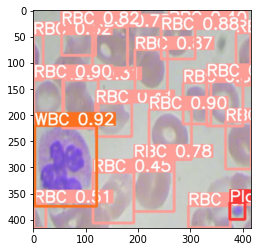

In [ ]:
img = plt.imread("/content/yolov5/runs/detect/exp5/BloodImage_00266_jpg.rf.2521623f1047a9502b2705a626ad6655.jpg")
plt.imshow(img)